<html>
    <summary></summary>
         <div> <p></p> </div>
         <div style="font-size: 20px; width: 800px;"> 
              <h1>
               <left>Intro to Bioinformatics in Python: downloading, analyzing sequences, and comparing biological sequences.</left>
              </h1>
              <p><left>============================================================================</left> </p>
<pre>Course: BIOM 421, Spring 2024
Instructor: Brian Munsky
Contact Info: munsky@colostate.edu
</pre>
         </div>
    </p>

</html>

<details>
  <summary>Copyright info</summary>

```
Copyright 2024 Brian Munsky

Redistribution and use in source and binary forms, with or without modification, are permitted provided that the following conditions are met:

1. Redistributions of source code must retain the above copyright notice, this list of conditions and the following disclaimer.

2. Redistributions in binary form must reproduce the above copyright notice, this list of conditions and the following disclaimer in the documentation and/or other materials provided with the distribution.

3. Neither the name of the copyright holder nor the names of its contributors may be used to endorse or promote products derived from this software without specific prior written permission.

THIS SOFTWARE IS PROVIDED BY THE COPYRIGHT HOLDERS AND CONTRIBUTORS "AS IS" AND ANY EXPRESS OR IMPLIED WARRANTIES, INCLUDING, BUT NOT LIMITED TO, THE IMPLIED WARRANTIES OF MERCHANTABILITY AND FITNESS FOR A PARTICULAR PURPOSE ARE DISCLAIMED. IN NO EVENT SHALL THE COPYRIGHT HOLDER OR CONTRIBUTORS BE LIABLE FOR ANY DIRECT, INDIRECT, INCIDENTAL, SPECIAL, EXEMPLARY, OR CONSEQUENTIAL DAMAGES (INCLUDING, BUT NOT LIMITED TO, PROCUREMENT OF SUBSTITUTE GOODS OR SERVICES; LOSS OF USE, DATA, OR PROFITS; OR BUSINESS INTERRUPTION) HOWEVER CAUSED AND ON ANY THEORY OF LIABILITY, WHETHER IN CONTRACT, STRICT LIABILITY, OR TORT (INCLUDING NEGLIGENCE OR OTHERWISE) ARISING IN ANY WAY OUT OF THE USE OF THIS SOFTWARE, EVEN IF ADVISED OF THE POSSIBILITY OF SUCH DAMAGE.
```
<details>



# Lesson Overview
In this lesson, we are going to use some common sequence manipulation and search tools to learn about the DNA, RNA and proteins related to the Corona Virus.

# I) Genomic Sequence Analysis

## 1) Downloading genomic data from an online database
First, we need to download information about corona virus from the genbank data base.  I did a quick internet seach and found that an accession number from Severe acute respiratory syndrome coronavirus 2 isolate  Wuhan-Hu-1, complete genome: MN908947.

In [2]:
import Bio
from Bio import Entrez, SeqIO, pairwise2, AlignIO, Phylo
from Bio.Blast import NCBIWWW, NCBIXML
from Bio.Seq import Seq
from Bio.SeqRecord import SeqRecord
from Bio.SeqUtils import ProtParam
from Bio.Phylo.TreeConstruction import DistanceCalculator, DistanceTreeConstructor

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import webbrowser
#
import os
import threading

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


/Users/Cassandra/anaconda3/envs/BIOM421/lib/python3.11/site-packages/Bio/pairwise2.py:278: BiopythonDeprecationWarning: Bio.pairwise2 has been deprecated, and we intend to remove it in a future release of Biopython. As an alternative, please consider using Bio.Align.PairwiseAligner as a replacement, and contact the Biopython developers if you still need the Bio.pairwise2 module.
  warnings.warn(


In [3]:
from Bio import Align
from Bio.Align import Alignment
from pymsaviz import MsaViz

In [4]:
#(PRELIMINARIES) Let's download the COVID19 virus sequence from NCBI
# Provide your email for accessing NCBI
Entrez.email = "cassandra.buffington@colostate.edu"  # Insert your email here

def get_genbank(accession_number):
    handle = Entrez.efetch(db="nucleotide", id=accession_number, rettype="gb", retmode="text")
    record = SeqIO.read(handle, "genbank")
    handle.close()
    return record

corona_virus = get_genbank("MN908947")

### 1.A) Exploring features of genomic data

Now that we have the data, let's explore to see what information is available to us:

In [5]:
# Let's look at what kinds of information are available to use in the data set:
print(corona_virus)

ID: MN908947.3
Name: MN908947
Description: Severe acute respiratory syndrome coronavirus 2 isolate Wuhan-Hu-1, complete genome
Number of features: 23
/molecule_type=ss-RNA
/topology=linear
/data_file_division=VRL
/date=18-MAR-2020
/accessions=['MN908947']
/sequence_version=3
/keywords=['']
/source=Severe acute respiratory syndrome coronavirus 2 (SARS-CoV-2)
/organism=Severe acute respiratory syndrome coronavirus 2
/taxonomy=['Viruses', 'Riboviria', 'Orthornavirae', 'Pisuviricota', 'Pisoniviricetes', 'Nidovirales', 'Cornidovirineae', 'Coronaviridae', 'Orthocoronavirinae', 'Betacoronavirus', 'Sarbecovirus', 'Severe acute respiratory syndrome-related coronavirus']
/references=[Reference(title='A new coronavirus associated with human respiratory disease in China', ...), Reference(title='Direct Submission', ...)]
/comment=On Jan 17, 2020 this sequence version replaced MN908947.2.
/structured_comment=defaultdict(<class 'dict'>, {'Assembly-Data': {'Assembly Method': 'Megahit v. V1.1.3', 'Sequ

In [6]:
# Print the first 1000 nucleotides.
print(corona_virus.seq[0:1000])         # Output the sequence to screen.

ATTAAAGGTTTATACCTTCCCAGGTAACAAACCAACCAACTTTCGATCTCTTGTAGATCTGTTCTCTAAACGAACTTTAAAATCTGTGTGGCTGTCACTCGGCTGCATGCTTAGTGCACTCACGCAGTATAATTAATAACTAATTACTGTCGTTGACAGGACACGAGTAACTCGTCTATCTTCTGCAGGCTGCTTACGGTTTCGTCCGTGTTGCAGCCGATCATCAGCACATCTAGGTTTCGTCCGGGTGTGACCGAAAGGTAAGATGGAGAGCCTTGTCCCTGGTTTCAACGAGAAAACACACGTCCAACTCAGTTTGCCTGTTTTACAGGTTCGCGACGTGCTCGTACGTGGCTTTGGAGACTCCGTGGAGGAGGTCTTATCAGAGGCACGTCAACATCTTAAAGATGGCACTTGTGGCTTAGTAGAAGTTGAAAAAGGCGTTTTGCCTCAACTTGAACAGCCCTATGTGTTCATCAAACGTTCGGATGCTCGAACTGCACCTCATGGTCATGTTATGGTTGAGCTGGTAGCAGAACTCGAAGGCATTCAGTACGGTCGTAGTGGTGAGACACTTGGTGTCCTTGTCCCTCATGTGGGCGAAATACCAGTGGCTTACCGCAAGGTTCTTCTTCGTAAGAACGGTAATAAAGGAGCTGGTGGCCATAGTTACGGCGCCGATCTAAAGTCATTTGACTTAGGCGACGAGCTTGGCACTGATCCTTATGAAGATTTTCAAGAAAACTGGAACACTAAACATAGCAGTGGTGTTACCCGTGAACTCATGCGTGAGCTTAACGGAGGGGCATACACTCGCTATGTCGATAACAACTTCTGTGGCCCTGATGGCTACCCTCTTGAGTGCATTAAAGACCTTCTAGCACGTGCTGGTAAAGCTTCATGCACTTTGTCCGAACAACTGGACTTTATTGACACTAAGAGGGGTGTATACTGCTGCCGTGAACATGAGCATGAAATTGCTTGGTACACGGAACGTTCT

In [7]:
# Find the length of the sequence
len(corona_virus.seq)  # Find the length of the sequence.

29903

In [8]:
# Explore what annotations are made about the sequence
corona_virus.annotations

{'molecule_type': 'ss-RNA',
 'topology': 'linear',
 'data_file_division': 'VRL',
 'date': '18-MAR-2020',
 'accessions': ['MN908947'],
 'sequence_version': 3,
 'keywords': [''],
 'source': 'Severe acute respiratory syndrome coronavirus 2 (SARS-CoV-2)',
 'organism': 'Severe acute respiratory syndrome coronavirus 2',
 'taxonomy': ['Viruses',
  'Riboviria',
  'Orthornavirae',
  'Pisuviricota',
  'Pisoniviricetes',
  'Nidovirales',
  'Cornidovirineae',
  'Coronaviridae',
  'Orthocoronavirinae',
  'Betacoronavirus',
  'Sarbecovirus',
  'Severe acute respiratory syndrome-related coronavirus'],
 'references': [Reference(title='A new coronavirus associated with human respiratory disease in China', ...),
  Reference(title='Direct Submission', ...)],
 'comment': 'On Jan 17, 2020 this sequence version replaced MN908947.2.',
 'structured_comment': defaultdict(dict,
             {'Assembly-Data': {'Assembly Method': 'Megahit v. V1.1.3',
               'Sequencing Technology': 'Illumina'}})}

In [9]:
# What is the taxonomy of the sequence?
corona_virus.annotations['taxonomy']

['Viruses',
 'Riboviria',
 'Orthornavirae',
 'Pisuviricota',
 'Pisoniviricetes',
 'Nidovirales',
 'Cornidovirineae',
 'Coronaviridae',
 'Orthocoronavirinae',
 'Betacoronavirus',
 'Sarbecovirus',
 'Severe acute respiratory syndrome-related coronavirus']

In [10]:
# What is the accession number?
corona_virus.annotations['accessions']

['MN908947']

In [11]:
# Let's get more information by going directly to the sequence entry on NCBI.
sequence_link = 'https://www.ncbi.nlm.nih.gov/nuccore/' + corona_virus.annotations['accessions'][0]
webbrowser.open_new(sequence_link)

True

In [12]:
# We can get even more information about the sequence by looking 
# at the original paper that described this sequence.  For this, 
# we will first need the PUBMED ID number:
print(corona_virus.annotations['references'][0].pubmed_id)

# With that we can launch a browser and find the article:
pubmed_link = 'https://www.ncbi.nlm.nih.gov/pubmed/' + corona_virus.annotations['references'][0].pubmed_id
webbrowser.open_new(pubmed_link)

32015508


True

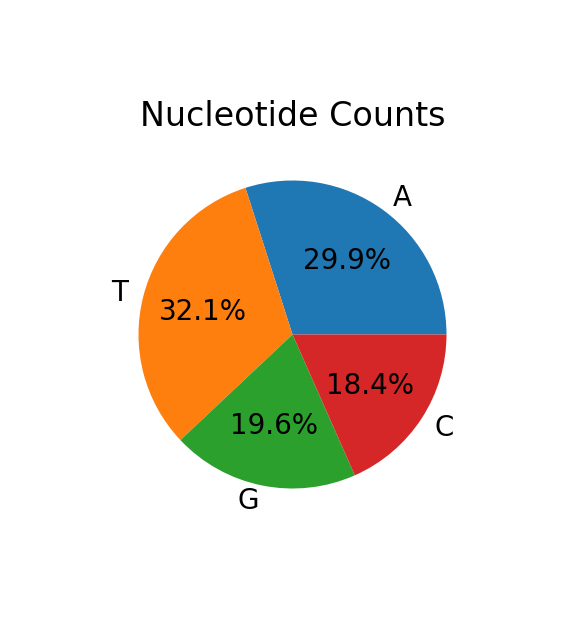

In [13]:
# Let's make a pie chart of the number of each nucleotide:

seq = str(corona_virus.seq)
neucleotides = 'ATGC'
counts = []
for i in range(4):
    counts.append(seq.count(neucleotides[i]))

plt.figure(figsize=(2.5, 2.5), dpi=200)
plt.pie(counts, labels=neucleotides, autopct='%1.1f%%')
plt.title('Nucleotide Counts')
plt.show()

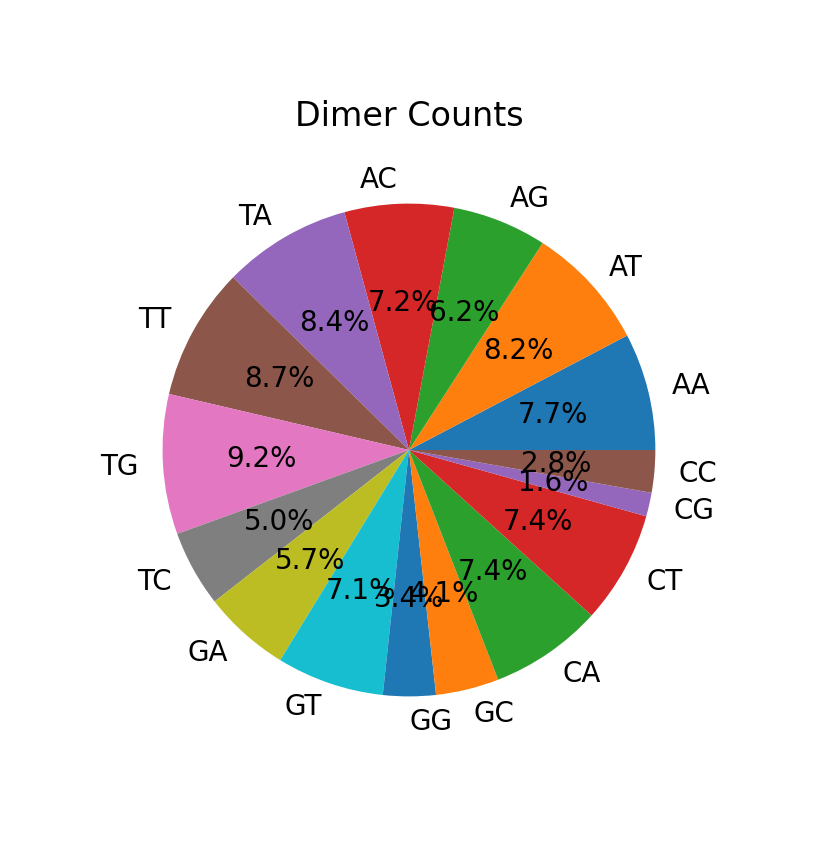

In [14]:
# Let's do the same thing, but for dimers:
neucleotides = 'ATGC'
counts = []
labels = []
for i in range(4):
    for j in range(4):
        counts.append(corona_virus.seq.count(neucleotides[i]+neucleotides[j]))
        labels.append(neucleotides[i]+neucleotides[j])

plt.figure(figsize=(4, 4), dpi=200)
plt.pie(counts, labels=labels, autopct='%1.1f%%')
plt.title('Dimer Counts')
plt.show()

### 1.B) Visualizing translation open reading frames
In the next cell, we examine a sequence to find what its sequence would translate to in amino acids, and then we plot all of the open reading frames (ORFs) in each frame.

In [15]:
# Print the AA sequence that would be coded for each frame:
frame = 0
AA_frame = corona_virus[frame:].translate(to_stop=False)
print(AA_frame.seq[1:1000])

KGLYLPR*QTNQLSISCRSVL*TNFKICVAVTRLHA*CTHAV*LITNYCR*QDTSNSSIFCRLLTVSSVLQPIISTSRFRPGVTER*DGEPCPWFQRENTRPTQFACFTGSRRARTWLWRLRGGGLIRGTSTS*RWHLWLSRS*KRRFAST*TALCVHQTFGCSNCTSWSCYG*AGSRTRRHSVRS*W*DTWCPCPSCGRNTSGLPQGSSS*ER**RSWWP*LRRRSKVI*LRRRAWH*SL*RFSRKLEH*T*QWCYP*THA*A*RRGIHSLCR*QLLWP*WLPS*VH*RPSSTCW*SFMHFVRTTGLY*H*EGCILLP*T*A*NCLVHGTF*KEL*IADTF*N*IGKEI*HLQWGMSKFCISLKFHNQDYSTKG*KEKA*WLYG*NSICLSSCVTK*MQPNVPFNSHEV*SLW*NFMADGRFC*SHLRILWH*EFD*RRCHYLWLLTPKCCC*NLLSSMSQFRSRT*A*SCRIP**IWLENHSS*GWSHYCLWRLCVLLCWLP*QVCLLGSTC*R*HRL*PYRCCWRRFRRS**QPS*NTPKRESQHQYCW*L*T**RDRHYFGIFFCFHKCFCGNCERFGL*SIQTNC*ILW*F*SYKRKS*KRCLEYW*TEINTESSLCICIRGCSCCTINFLPHS*NCSKFCACFTEGRYNNTRWNFTVFTETH*CYDVHI*FGY*QSSCNGLHYRWCCSVDFAVAN*HLWHCL*KTQTRP*LA*REV*GRCRVS*RRLGNC*IYLNLCL*NCRWTNCHLCKGN*GECSDIL*ACK*IFGFVC*LYHYWWS*T*SLEFR*NICHALKGIVQKVC*IQRRNWPTHASKSPKRNYLLRGRNTSHRSVNRGSCLENW*FTTIRTTY**SC*SSIGWYTSLY*RAYVARNQRHRKVLCPCT*YDGNKQYLHTQRRCTNKGYFW**HCDRSARLQECEYHF*T**KD**ST**EVLCLYS*TRYRSK*VRLCCGRCCHKNFATSI*ITYTTGH*FR*VEYGYILLI**VW


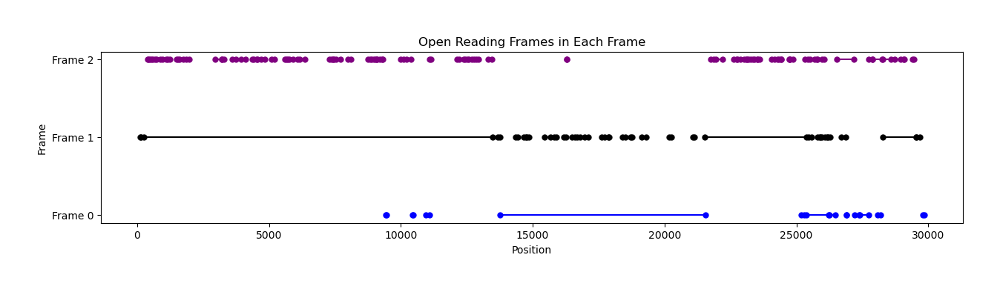

In [16]:
# Now, let's make a plot of the open reading frames to show where they are on the sequence.

# Function to find ORFs in all frames of a sequence
def find_all_orfs(sequence):
    orf_list = []           # List of all the ORF we find
    for frame in range(3):  # Check each of the three reading frames
        orfs = []           # List of ORFs for the current frame   
        lastStop = frame    # Position of last stop codon.
        for orf in sequence[frame:].translate(to_stop=False).split('*'):     # Translate the curent frame sequence into AA and break up by stop codons
            if len(orf) > 30:                                                # Consider ORFs longer than 50 amino acids
                start = lastStop + orf.find('M') * 3 if 'M' in orf else None # Update start codon position to next M, 
                stop = lastStop + (len(orf))*3 if 'M' in orf else None       # Update stop codon to next '*'
                if start is not None and stop is not None:                   # In the coding region is >30AA
                    orfs.append((start, stop))                                      # Append the start and stop positions for that ORF
            lastStop += len(orf)*3 + 3           # Update the position of the last stop codon
        orf_list.append(orfs)                    # Append the list of ORFs for the current frame
    return orf_list

# Find all ORFs in each frame of the sequence
orf_positions = find_all_orfs(corona_virus.seq)

# Visualize ORFs on the sequence for each frame
plt.figure(figsize=(15, 3))
colors = ['blue','black','purple']
for frame, orfs in enumerate(orf_positions):
    for start, stop in orfs:
        plt.plot([start, stop], [frame, frame], marker='o', color=colors[frame], markersize=5)
plt.title('Open Reading Frames in Each Frame')
plt.xlabel('Position')
plt.ylabel('Frame')
plt.yticks([0, 1, 2], ['Frame 0', 'Frame 1', 'Frame 2'])
plt.show()

### 1.B) Exploring advanced features in the genome

Here is an example for how to download the genbank file to disk so that you can analyse it later.

In [17]:
def download_genbank(accession_number, output_file):
    try:
        # Fetch the GenBank record
        handle = Entrez.efetch(db="nucleotide", id=accession_number, rettype="gb", retmode="text")

        # Write the record to a file
        with open(output_file, "w") as f:
            f.write(handle.read())

        print(f"GenBank record downloaded and saved to {output_file}")

    except Exception as e:
        print(f"Error: {e}")

# Example: Download GenBank record for a given accession number
accession_number = "MN908947"  # Replace with your accession number
output_file = "coronaVirus.gb"

download_genbank(accession_number, output_file)

GenBank record downloaded and saved to coronaVirus.gb


In [18]:
# Now that the file is saved, you can re-open it to get the information.
def extract_features(genbank_file):
    for record in SeqIO.parse(genbank_file, 'genbank'):
        for feature in record.features:
            print(f"Feature Type: {feature.type}")
            print(f"Location: {feature.location}")
            print(f"Qualifiers: {feature.qualifiers}")

extract_features(output_file)

Feature Type: source
Location: [0:29903](+)
Qualifiers: {'organism': ['Severe acute respiratory syndrome coronavirus 2'], 'mol_type': ['genomic RNA'], 'isolate': ['Wuhan-Hu-1'], 'host': ['Homo sapiens'], 'db_xref': ['taxon:2697049'], 'country': ['China'], 'collection_date': ['Dec-2019']}
Feature Type: 5'UTR
Location: [0:265](+)
Qualifiers: {}
Feature Type: gene
Location: [265:21555](+)
Qualifiers: {'gene': ['orf1ab']}
Feature Type: CDS
Location: join{[265:13468](+), [13467:21555](+)}
Qualifiers: {'gene': ['orf1ab'], 'ribosomal_slippage': [''], 'note': ['pp1ab; translated by -1 ribosomal frameshift'], 'codon_start': ['1'], 'product': ['orf1ab polyprotein'], 'protein_id': ['QHD43415.1'], 'translation': ['MESLVPGFNEKTHVQLSLPVLQVRDVLVRGFGDSVEEVLSEARQHLKDGTCGLVEVEKGVLPQLEQPYVFIKRSDARTAPHGHVMVELVAELEGIQYGRSGETLGVLVPHVGEIPVAYRKVLLRKNGNKGAGGHSYGADLKSFDLGDELGTDPYEDFQENWNTKHSSGVTRELMRELNGGAYTRYVDNNFCGPDGYPLECIKDLLARAGKASCTLSEQLDFIDTKRGVYCCREHEHEIAWYTERSEKSYELQTPFEIKLAKKFDTFNGECPNFVFPLNSIIKTIQPRV

## 2) Comparing and Aligning Two Sequences

In [19]:
# (ALIGNMENT) Lets try to align the virus sequence with the BioNTech/Phizer and Moderna vaccines
#      First, lets create the sequences for the two vacines from the following paper: 
#      https://github.com/NAalytics/Assemblies-of-putative-SARS-CoV2-spike-encoding-mRNA-sequences-for-
#          vaccines-BNT-162b2-and-mRNA-1273/blob/main/Assemblies%20of%20putative%20SARS-CoV2-spike-encoding
#          %20mRNA%20sequences%20for%20vaccines%20BNT-162b2%20and%20mRNA-1273.docx.pdf
BNT_Phizer = '''GAGAATAAACTAGTATTCTTCTGGTCCCCACAGACTCAGAGAGAACCCGCCACCATGTTCGTGTTCCTGGTGCTGCTGCCTCTGGTGTCCA
GCCAGTGTGTGAACCTGACCACCAGAACACAGCTGCCTCCAGCCTACACCAACAGCTTTACCAGAGGCGTGTACTACCCCGACAAGGTGTT
CAGATCCAGCGTGCTGCACTCTACCCAGGACCTGTTCCTGCCTTTCTTCAGCAACGTGACCTGGTTCCACGCCATCCACGTGTCCGGCACC
AATGGCACCAAGAGATTCGACAACCCCGTGCTGCCCTTCAACGACGGGGTGTACTTTGCCAGCACCGAGAAGTCCAACATCATCAGAGGCT
GGATCTTCGGCACCACACTGGACAGCAAGACCCAGAGCCTGCTGATCGTGAACAACGCCACCAACGTGGTCATCAAAGTGTGCGAGTTCCA
GTTCTGCAACGACCCCTTCCTGGGCGTCTACTACCACAAGAACAACAAGAGCTGGATGGAAAGCGAGTTCCGGGTGTACAGCAGCGCCAAC
AACTGCACCTTCGAGTACGTGTCCCAGCCTTTCCTGATGGACCTGGAAGGCAAGCAGGGCAACTTCAAGAACCTGCGCGAGTTCGTGTTTA
AGAACATCGACGGCTACTTCAAGATCTACAGCAAGCACACCCCTATCAACCTCGTGCGGGATCTGCCTCAGGGCTTCTCTGCTCTGGAACC
CCTGGTGGATCTGCCCATCGGCATCAACATCACCCGGTTTCAGACACTGCTGGCCCTGCACAGAAGCTACCTGACACCTGGCGATAGCAGC
AGCGGATGGACAGCTGGTGCCGCCGCTTACTATGTGGGCTACCTGCAGCCTAGAACCTTCCTGCTGAAGTACAACGAGAACGGCACCATCA
CCGACGCCGTGGATTGTGCTCTGGATCCTCTGAGCGAGACAAAGTGCACCCTGAAGTCCTTCACCGTGGAAAAGGGCATCTACCAGACCAG
CAACTTCCGGGTGCAGCCCACCGAATCCATCGTGCGGTTCCCCAATATCACCAATCTGTGCCCCTTCGGCGAGGTGTTCAATGCCACCAGA
TTCGCCTCTGTGTACGCCTGGAACCGGAAGCGGATCAGCAATTGCGTGGCCGACTACTCCGTGCTGTACAACTCCGCCAGCTTCAGCACCT
TCAAGTGCTACGGCGTGTCCCCTACCAAGCTGAACGACCTGTGCTTCACAAACGTGTACGCCGACAGCTTCGTGATCCGGGGAGATGAAGT
GCGGCAGATTGCCCCTGGACAGACAGGCAAGATCGCCGACTACAACTACAAGCTGCCCGACGACTTCACCGGCTGTGTGATTGCCTGGAAC
AGCAACAACCTGGACTCCAAAGTCGGCGGCAACTACAATTACCTGTACCGGCTGTTCCGGAAGTCCAATCTGAAGCCCTTCGAGCGGGACA
TCTCCACCGAGATCTATCAGGCCGGCAGCACCCCTTGTAACGGCGTGGAAGGCTTCAACTGCTACTTCCCACTGCAGTCCTACGGCTTTCA
GCCCACAAATGGCGTGGGCTATCAGCCCTACAGAGTGGTGGTGCTGAGCTTCGAACTGCTGCATGCCCCTGCCACAGTGTGCGGCCCTAAG
AAAAGCACCAATCTCGTGAAGAACAAATGCGTGAACTTCAACTTCAACGGCCTGACCGGCACCGGCGTGCTGACAGAGAGCAACAAGAAGT
TCCTGCCATTCCAGCAGTTTGGCCGGGATATCGCCGATACCACAGACGCCGTTAGAGATCCCCAGACACTGGAAATCCTGGACATCACCCC
TTGCAGCTTCGGCGGAGTGTCTGTGATCACCCCTGGCACCAACACCAGCAATCAGGTGGCAGTGCTGTACCAGGACGTGAACTGTACCGAA
GTGCCCGTGGCCATTCACGCCGATCAGCTGACACCTACATGGCGGGTGTACTCCACCGGCAGCAATGTGTTTCAGACCAGAGCCGGCTGTC
TGATCGGAGCCGAGCACGTGAACAATAGCTACGAGTGCGACATCCCCATCGGCGCTGGAATCTGCGCCAGCTACCAGACACAGACAAACAG
CCCTCGGAGAGCCAGAAGCGTGGCCAGCCAGAGCATCATTGCCTACACAATGTCTCTGGGCGCCGAGAACAGCGTGGCCTACTCCAACAAC
TCTATCGCTATCCCCACCAACTTCACCATCAGCGTGACCACAGAGATCCTGCCTGTGTCCATGACCAAGACCAGCGTGGACTGCACCATGT
ACATCTGCGGCGATTCCACCGAGTGCTCCAACCTGCTGCTGCAGTACGGCAGCTTCTGCACCCAGCTGAATAGAGCCCTGACAGGGATCGC
CGTGGAACAGGACAAGAACACCCAAGAGGTGTTCGCCCAAGTGAAGCAGATCTACAAGACCCCTCCTATCAAGGACTTCGGCGGCTTCAAT
TTCAGCCAGATTCTGCCCGATCCTAGCAAGCCCAGCAAGCGGAGCTTCATCGAGGACCTGCTGTTCAACAAAGTGACACTGGCCGACGCCG
GCTTCATCAAGCAGTATGGCGATTGTCTGGGCGACATTGCCGCCAGGGATCTGATTTGCGCCCAGAAGTTTAACGGACTGACAGTGCTGCC
TCCTCTGCTGACCGATGAGATGATCGCCCAGTACACATCTGCCCTGCTGGCCGGCACAATCACAAGCGGCTGGACATTTGGAGCAGGCGCC
GCTCTGCAGATCCCCTTTGCTATGCAGATGGCCTACCGGTTCAACGGCATCGGAGTGACCCAGAATGTGCTGTACGAGAACCAGAAGCTGA
TCGCCAACCAGTTCAACAGCGCCATCGGCAAGATCCAGGACAGCCTGAGCAGCACAGCAAGCGCCCTGGGAAAGCTGCAGGACGTGGTCAA
CCAGAATGCCCAGGCACTGAACACCCTGGTCAAGCAGCTGTCCTCCAACTTCGGCGCCATCAGCTCTGTGCTGAACGATATCCTGAGCAGA
CTGGACCCTCCTGAGGCCGAGGTGCAGATCGACAGACTGATCACAGGCAGACTGCAGAGCCTCCAGACATACGTGACCCAGCAGCTGATCA
GAGCCGCCGAGATTAGAGCCTCTGCCAATCTGGCCGCCACCAAGATGTCTGAGTGTGTGCTGGGCCAGAGCAAGAGAGTGGACTTTTGCGG
CAAGGGCTACCACCTGATGAGCTTCCCTCAGTCTGCCCCTCACGGCGTGGTGTTTCTGCACGTGACATATGTGCCCGCTCAAGAGAAGAAT
TTCACCACCGCTCCAGCCATCTGCCACGACGGCAAAGCCCACTTTCCTAGAGAAGGCGTGTTCGTGTCCAACGGCACCCATTGGTTCGTGA
CACAGCGGAACTTCTACGAGCCCCAGATCATCACCACCGACAACACCTTCGTGTCTGGCAACTGCGACGTCGTGATCGGCATTGTGAACAA
TACCGTGTACGACCCTCTGCAGCCCGAGCTGGACAGCTTCAAAGAGGAACTGGACAAGTACTTTAAGAACCACACAAGCCCCGACGTGGAC
CTGGGCGATATCAGCGGAATCAATGCCAGCGTCGTGAACATCCAGAAAGAGATCGACCGGCTGAACGAGGTGGCCAAGAATCTGAACGAGA
GCCTGATCGACCTGCAAGAACTGGGGAAGTACGAGCAGTACATCAAGTGGCCCTGGTACATCTGGCTGGGCTTTATCGCCGGACTGATTGC
CATCGTGATGGTCACAATCATGCTGTGTTGCATGACCAGCTGCTGTAGCTGCCTGAAGGGCTGTTGTAGCTGTGGCAGCTGCTGCAAGTTC
GACGAGGACGATTCTGAGCCCGTGCTGAAGGGCGTGAAACTGCACTACACATGATGACTCGAGCTGGTACTGCATGCACGCAATGCTAGCT
GCCCCTTTCCCGTCCTGGGTACCCCGAGTCTCCCCCGACCTCGGGTCCCAGGTATGCTCCCACCTCCACCTGCCCCACTCACCACCTCTGC
TAGTTCCAGACACCTCCCAAGCACGCAGCAATGCAGCTCAAAACGCTTAGCCTAGCCACACCCCCACGGGAAACAGCAGTGATTAACCTTT
AGCAATAAACGAAAGTTTAACTAAGCTATACTAACCCCAGGGTTGGTCAATTTCGTGCCAGCCACACCCTGGAGCTAGCA'''
BNT_Phizer = BNT_Phizer.replace("\n", "")

Moderna = '''GGGAAATAAGAGAGAAAAGAAGAGTAAGAAGAAATATAAGACCCCGGCGCCGCCACCATGTTCGTGTTCCTGGTGCTGCTGCCCCTGGTGA
GCAGCCAGTGCGTGAACCTGACCACCCGGACCCAGCTGCCACCAGCCTACACCAACAGCTTCACCCGGGGCGTCTACTACCCCGACAAGGT
GTTCCGGAGCAGCGTCCTGCACAGCACCCAGGACCTGTTCCTGCCCTTCTTCAGCAACGTGACCTGGTTCCACGCCATCCACGTGAGCGGC
ACCAACGGCACCAAGCGGTTCGACAACCCCGTGCTGCCCTTCAACGACGGCGTGTACTTCGCCAGCACCGAGAAGAGCAACATCATCCGGG
GCTGGATCTTCGGCACCACCCTGGACAGCAAGACCCAGAGCCTGCTGATCGTGAATAACGCCACCAACGTGGTGATCAAGGTGTGCGAGTT
CCAGTTCTGCAACGACCCCTTCCTGGGCGTGTACTACCACAAGAACAACAAGAGCTGGATGGAGAGCGAGTTCCGGGTGTACAGCAGCGCC
AACAACTGCACCTTCGAGTACGTGAGCCAGCCCTTCCTGATGGACCTGGAGGGCAAGCAGGGCAACTTCAAGAACCTGCGGGAGTTCGTGT
TCAAGAACATCGACGGCTACTTCAAGATCTACAGCAAGCACACCCCAATCAACCTGGTGCGGGATCTGCCCCAGGGCTTCTCAGCCCTGGA
GCCCCTGGTGGACCTGCCCATCGGCATCAACATCACCCGGTTCCAGACCCTGCTGGCCCTGCACCGGAGCTACCTGACCCCAGGCGACAGC
AGCAGCGGGTGGACAGCAGGCGCGGCTGCTTACTACGTGGGCTACCTGCAGCCCCGGACCTTCCTGCTGAAGTACAACGAGAACGGCACCA
TCACCGACGCCGTGGACTGCGCCCTGGACCCTCTGAGCGAGACCAAGTGCACCCTGAAGAGCTTCACCGTGGAGAAGGGCATCTACCAGAC
CAGCAACTTCCGGGTGCAGCCCACCGAGAGCATCGTGCGGTTCCCCAACATCACCAACCTGTGCCCCTTCGGCGAGGTGTTCAACGCCACC
CGGTTCGCCAGCGTGTACGCCTGGAACCGGAAGCGGATCAGCAACTGCGTGGCCGACTACAGCGTGCTGTACAACAGCGCCAGCTTCAGCA
CCTTCAAGTGCTACGGCGTGAGCCCCACCAAGCTGAACGACCTGTGCTTCACCAACGTGTACGCCGACAGCTTCGTGATCCGTGGCGACGA
GGTGCGGCAGATCGCACCCGGCCAGACAGGCAAGATCGCCGACTACAACTACAAGCTGCCCGACGACTTCACCGGCTGCGTGATCGCCTGG
AACAGCAACAACCTCGACAGCAAGGTGGGCGGCAACTACAACTACCTGTACCGGCTGTTCCGGAAGAGCAACCTGAAGCCCTTCGAGCGGG
ACATCAGCACCGAGATCTACCAAGCCGGCTCCACCCCTTGCAACGGCGTGGAGGGCTTCAACTGCTACTTCCCTCTGCAGAGCTACGGCTT
CCAGCCCACCAACGGCGTGGGCTACCAGCCCTACCGGGTGGTGGTGCTGAGCTTCGAGCTGCTGCACGCCCCAGCCACCGTGTGTGGCCCC
AAGAAGAGCACCAACCTGGTGAAGAACAAGTGCGTGAACTTCAACTTCAACGGCCTTACCGGCACCGGCGTGCTGACCGAGAGCAACAAGA
AATTCCTGCCCTTTCAGCAGTTCGGCCGGGACATCGCCGACACCACCGACGCTGTGCGGGATCCCCAGACCCTGGAGATCCTGGACATCAC
CCCTTGCAGCTTCGGCGGCGTGAGCGTGATCACCCCAGGCACCAACACCAGCAACCAGGTGGCCGTGCTGTACCAGGACGTGAACTGCACC
GAGGTGCCCGTGGCCATCCACGCCGACCAGCTGACACCCACCTGGCGGGTCTACAGCACCGGCAGCAACGTGTTCCAGACCCGGGCCGGTT
GCCTGATCGGCGCCGAGCACGTGAACAACAGCTACGAGTGCGACATCCCCATCGGCGCCGGCATCTGTGCCAGCTACCAGACCCAGACCAA
TTCACCCCGGAGGGCAAGGAGCGTGGCCAGCCAGAGCATCATCGCCTACACCATGAGCCTGGGCGCCGAGAACAGCGTGGCCTACAGCAAC
AACAGCATCGCCATCCCCACCAACTTCACCATCAGCGTGACCACCGAGATTCTGCCCGTGAGCATGACCAAGACCAGCGTGGACTGCACCA
TGTACATCTGCGGCGACAGCACCGAGTGCAGCAACCTGCTGCTGCAGTACGGCAGCTTCTGCACCCAGCTGAACCGGGCCCTGACCGGCAT
CGCCGTGGAGCAGGACAAGAACACCCAGGAGGTGTTCGCCCAGGTGAAGCAGATCTACAAGACCCCTCCCATCAAGGACTTCGGCGGCTTC
AACTTCAGCCAGATCCTGCCCGACCCCAGCAAGCCCAGCAAGCGGAGCTTCATCGAGGACCTGCTGTTCAACAAGGTGACCCTAGCCGACG
CCGGCTTCATCAAGCAGTACGGCGACTGCCTCGGCGACATAGCCGCCCGGGACCTGATCTGCGCCCAGAAGTTCAACGGCCTGACCGTGCT
GCCTCCCCTGCTGACCGACGAGATGATCGCCCAGTACACCAGCGCCCTGTTAGCCGGAACCATCACCAGCGGCTGGACTTTCGGCGCTGGA
GCCGCTCTGCAGATCCCCTTCGCCATGCAGATGGCCTACCGGTTCAACGGCATCGGCGTGACCCAGAACGTGCTGTACGAGAACCAGAAGC
TGATCGCCAACCAGTTCAACAGCGCCATCGGCAAGATCCAGGACAGCCTGAGCAGCACCGCTAGCGCCCTGGGCAAGCTGCAGGACGTGGT
GAACCAGAACGCCCAGGCCCTGAACACCCTGGTGAAGCAGCTGAGCAGCAACTTCGGCGCCATCAGCAGCGTGCTGAACGACATCCTGAGC
CGGCTGGACCCTCCCGAGGCCGAGGTGCAGATCGACCGGCTGATCACTGGCCGGCTGCAGAGCCTGCAGACCTACGTGACCCAGCAGCTGA
TCCGGGCCGCCGAGATTCGGGCCAGCGCCAACCTGGCCGCCACCAAGATGAGCGAGTGCGTGCTGGGCCAGAGCAAGCGGGTGGACTTCTG
CGGCAAGGGCTACCACCTGATGAGCTTTCCCCAGAGCGCACCCCACGGAGTGGTGTTCCTGCACGTGACCTACGTGCCCGCCCAGGAGAAG
AACTTCACCACCGCCCCAGCCATCTGCCACGACGGCAAGGCCCACTTTCCCCGGGAGGGCGTGTTCGTGAGCAACGGCACCCACTGGTTCG
TGACCCAGCGGAACTTCTACGAGCCCCAGATCATCACCACCGACAACACCTTCGTGAGCGGCAACTGCGACGTGGTGATCGGCATCGTGAA
CAACACCGTGTACGATCCCCTGCAGCCCGAGCTGGACAGCTTCAAGGAGGAGCTGGACAAGTACTTCAAGAATCACACCAGCCCCGACGTG
GACCTGGGCGACATCAGCGGCATCAACGCCAGCGTGGTGAACATCCAGAAGGAGATCGATCGGCTGAACGAGGTGGCCAAGAACCTGAACG
AGAGCCTGATCGACCTGCAGGAGCTGGGCAAGTACGAGCAGTACATCAAGTGGCCCTGGTACATCTGGCTGGGCTTCATCGCCGGCCTGAT
CGCCATCGTGATGGTGACCATCATGCTGTGCTGCATGACCAGCTGCTGCAGCTGCCTGAAGGGCTGTTGCAGCTGCGGCAGCTGCTGCAAG
TTCGACGAGGACGACAGCGAGCCCGTGCTGAAGGGCGTGAAGCTGCACTACACCTGATAATAGGCTGGAGCCTCGGTGGCCTAGCTTCTTG
CCCCTTGGGCCTCCCCCCAGCCCCTCCTCCCCTTCCTGCACCCGTACCCCCGTGGTCTTTGAATAAAGTCTGAGTGGGCGGCAAAAAAAAA'''

Moderna = Moderna.replace("\n", "")

### 2.A) Aligning nucleotide sequences
Now that we have two sequences, let's align them (arrange them to maximize similarities in their sequences). To do this, first we run pairwise alignment using *pairwise2* from the *Bio* package.

In [20]:
# Perform sequence alignment
alignment_BNT_MOD = pairwise2.align.globalxx(BNT_Phizer, Moderna)[0]
alignment_VIR_MOD = pairwise2.align.globalxx(corona_virus.seq, Moderna)[0]
alignment_VIR_BNT = pairwise2.align.globalxx(corona_virus.seq, BNT_Phizer)[0]

# Define a simple function for visualizing sequence alignments
def visualize_alignment(alignment, headers):
    seq1, seq2, score, begin, end = alignment
    print(f"Alignment Score: {score}")

# Display alignments
print("Alignment between BNT_Phizer and Moderna:")
visualize_alignment(alignment_BNT_MOD, ['BioNTech', 'Moderna'])

print("\nAlignment between Virus and Moderna:")
visualize_alignment(alignment_VIR_MOD, ['Virus', 'Moderna'])

print("\nAlignment between Virus and BNT_Phizer:")
visualize_alignment(alignment_VIR_BNT, ['Virus', 'BioNTech'])

Alignment between BNT_Phizer and Moderna:
Alignment Score: 3632.0

Alignment between Virus and Moderna:
Alignment Score: 4004.0

Alignment between Virus and BNT_Phizer:
Alignment Score: 4175.0


### 2.B) Saving alignments as FASTA files
Sequence data is usually saved in *FASTA* formatted files, and saving our data in that format will come in handy later when we want to call other functions for visualization.  So, let's save our results to a file:

In [21]:
# Create SeqRecord objects for the aligned sequences
seq_record1 = SeqRecord(Seq(alignment_BNT_MOD[0]), id='BioNTech')
seq_record2 = SeqRecord(Seq(alignment_BNT_MOD[1]), id='Moderna')

# Save alignment to a .fa file
alignment_records = [seq_record1, seq_record2]
output_file = 'alignment_results.fa'
SeqIO.write(alignment_records, output_file, 'fasta')

2

### 2.C) Visualizing sequence allignments
Now that we have the sequences aligned to one another, it is very helpful to generate a plot to visualize the two sequence's similarities.  Let's make a plot and save it to a file.

In [22]:
msa_file = "alignment_results.fa"
mv = MsaViz(msa_file, wrap_length=200, show_count=True)
mv.savefig("BioNTech_vs_Moderna_Alignment.png")

#### Loading and displaying an image
Now, let's load that image so that we can look at our results.

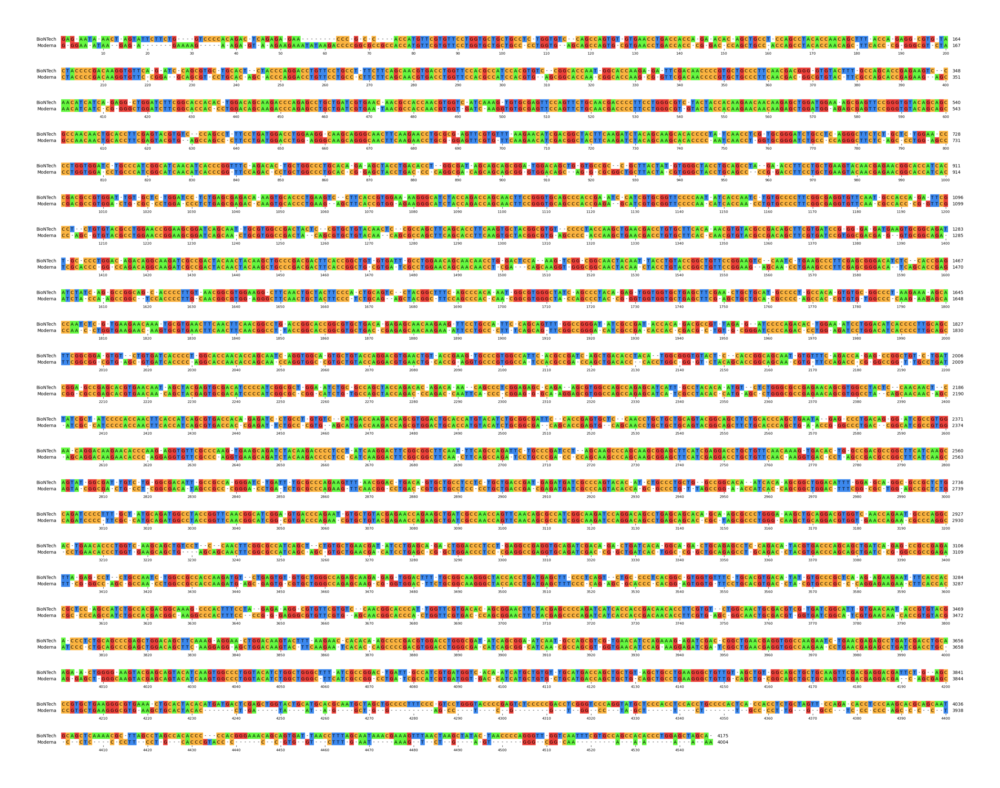

In [23]:
# Load the image
img = mpimg.imread('BioNTech_vs_Moderna_Alignment.png')

# Display the image
fig = plt.figure(figsize=(30, 30), dpi=200)
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()

### 2.D) Comparing and aligning amino acid sequences

In [24]:
# Find all ORFs in each frame of the vaccine sequences
seqModerna = Seq(Moderna)
seqBNTPhizer = Seq(BNT_Phizer)

# Now we can use our previous code to find the ORFs
Moderna_orf_positions = find_all_orfs(seqModerna)
BNT_Phizer_orf_positions = find_all_orfs(seqBNTPhizer)

In [25]:
# Next, let's find the amino acid sequence for the largest open reading frame from each vaccine
def pickLargestORF(orfs):
    maxLength = 0;
    for frame, orfs in enumerate(orfs):
        for start, stop in orfs:
            if (stop-start)>maxLength:
                largestStart = start
                largestStop = stop
                maxLength = stop-start
            
    return largestStart, largestStop

startMod, stopMod = pickLargestORF(Moderna_orf_positions)
ModernaAA = seqModerna[startMod:stopMod].translate(to_stop=False)
print(ModernaAA)

startBNT, stopBNT = pickLargestORF(BNT_Phizer_orf_positions)
BNTPhiAA = seqBNTPhizer[startBNT:stopBNT].translate(to_stop=False)
print(BNTPhiAA)

MFVFLVLLPLVSSQCVNLTTRTQLPPAYTNSFTRGVYYPDKVFRSSVLHSTQDLFLPFFSNVTWFHAIHVSGTNGTKRFDNPVLPFNDGVYFASTEKSNIIRGWIFGTTLDSKTQSLLIVNNATNVVIKVCEFQFCNDPFLGVYYHKNNKSWMESEFRVYSSANNCTFEYVSQPFLMDLEGKQGNFKNLREFVFKNIDGYFKIYSKHTPINLVRDLPQGFSALEPLVDLPIGINITRFQTLLALHRSYLTPGDSSSGWTAGAAAYYVGYLQPRTFLLKYNENGTITDAVDCALDPLSETKCTLKSFTVEKGIYQTSNFRVQPTESIVRFPNITNLCPFGEVFNATRFASVYAWNRKRISNCVADYSVLYNSASFSTFKCYGVSPTKLNDLCFTNVYADSFVIRGDEVRQIAPGQTGKIADYNYKLPDDFTGCVIAWNSNNLDSKVGGNYNYLYRLFRKSNLKPFERDISTEIYQAGSTPCNGVEGFNCYFPLQSYGFQPTNGVGYQPYRVVVLSFELLHAPATVCGPKKSTNLVKNKCVNFNFNGLTGTGVLTESNKKFLPFQQFGRDIADTTDAVRDPQTLEILDITPCSFGGVSVITPGTNTSNQVAVLYQDVNCTEVPVAIHADQLTPTWRVYSTGSNVFQTRAGCLIGAEHVNNSYECDIPIGAGICASYQTQTNSPRRARSVASQSIIAYTMSLGAENSVAYSNNSIAIPTNFTISVTTEILPVSMTKTSVDCTMYICGDSTECSNLLLQYGSFCTQLNRALTGIAVEQDKNTQEVFAQVKQIYKTPPIKDFGGFNFSQILPDPSKPSKRSFIEDLLFNKVTLADAGFIKQYGDCLGDIAARDLICAQKFNGLTVLPPLLTDEMIAQYTSALLAGTITSGWTFGAGAALQIPFAMQMAYRFNGIGVTQNVLYENQKLIANQFNSAIGKIQDSLSSTASALGKLQDVVNQNAQALNTLVKQLSSNFGAISSVLNDILSRLDPPEAEVQIDRLITGR

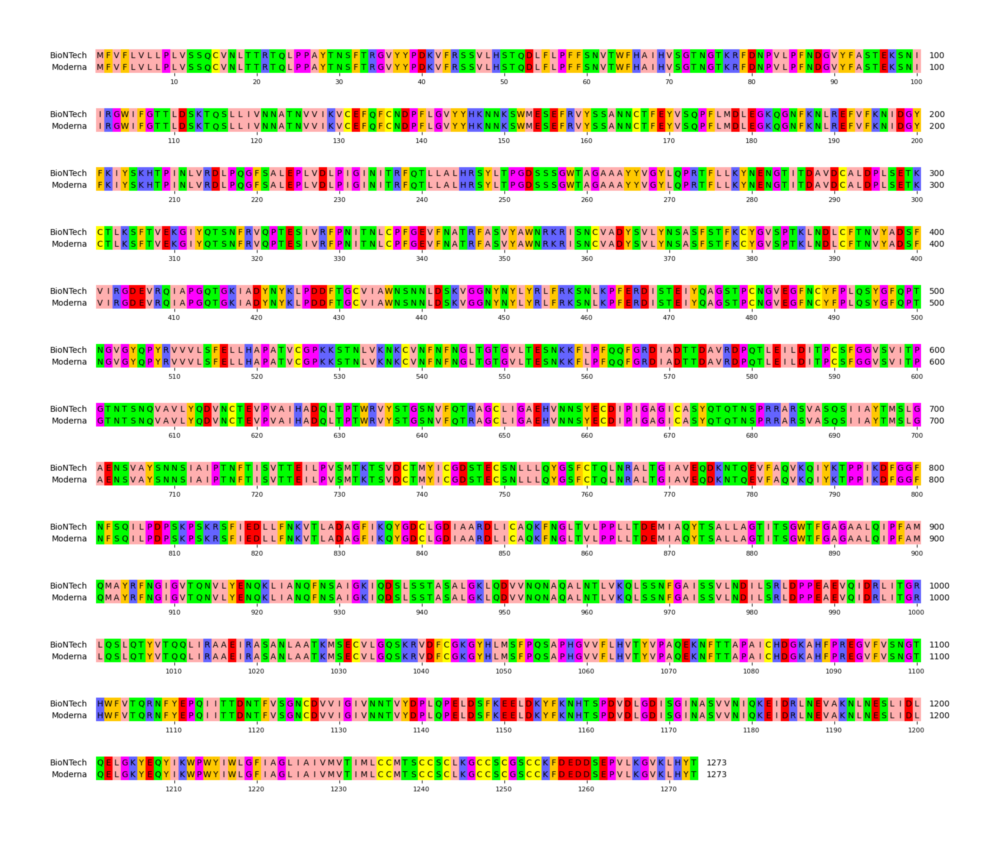

In [26]:
#Now, lets align the vaccine amino acid sequences to one another. For this, we are just going to copy some of 
# the codes from before.

# Perform sequence alignment
alignment_BNTaa_MODaa = pairwise2.align.globalxx(BNTPhiAA, ModernaAA)[0]

# Create SeqRecord objects for the aligned sequences
seq_record1 = SeqRecord(Seq(alignment_BNTaa_MODaa[0]), id='BioNTech')
seq_record2 = SeqRecord(Seq(alignment_BNTaa_MODaa[1]), id='Moderna')

# Save alignment to a .fa file
alignment_records = [seq_record1, seq_record2]
output_file = 'alignment_results_AA.fa'
SeqIO.write(alignment_records, output_file, 'fasta')

# Make and save an alignment figure
mv = MsaViz(output_file, wrap_length=100, show_count=True)
mv.savefig("BioNTech_vs_Moderna_Alignment.png")

# Load the image
img = mpimg.imread('BioNTech_vs_Moderna_Alignment.png')

# Display the image
fig = plt.figure(figsize=(30, 30), dpi=200)
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()

## 3) Comparing and Aligning Multiple Protein Sequences
Now, let's see how the Moderna and BNT/Phizer vaccinnes compare to the original virus sequence.  

In [27]:
# Let's start by finding the 10 largest ORFs in the virus genome:
def pickNLargestORF(orfs,N=5):
    Lengths = []
    Bounds = []
    for frame, orf in enumerate(orfs):
        for start, stop in orf:
            Lengths.append(stop-start)
            Bounds.append([start,stop])
    enumerated_list = list(enumerate(Lengths))
    sortedLengths = sorted(enumerated_list, key=lambda x: abs(x[1]), reverse=True)
 
    # Extract indices of the N largest magnitude entries
    largest_indices = [index for index, _ in sortedLengths[:N]]
    
    # Extract lengths and bounds for those indices
    longestLengths = [Lengths[index] for index, _ in sortedLengths[:N]]
    Bounds = [Bounds[index] for index, _ in sortedLengths[:N]]
       
    return Bounds

longestORFbounds = pickNLargestORF(orf_positions,10)
longestORFsequences = [corona_virus.seq[longestORFbounds[index][0]:].translate(to_stop=True) for index in range(10)]
print(longestORFsequences)

[Seq('MESLVPGFNEKTHVQLSLPVLQVRDVLVRGFGDSVEEVLSEARQHLKDGTCGLV...FAV'), Seq('MVPHISRQRLTKYTMADLVYALRHFDEGNCDTLKEILVTYNCCDDDYFNKKDWY...VNN'), Seq('MFLLTTKRTMFVFLVLLPLVSSQCVNLTTRTQLPPAYTNSFTRGVYYPDKVFRS...HYT'), Seq('MSDNGPQNQRNAPRITFGGPSDSTGSNQNGERSGARSKQRRPQGLPNNTASWFT...TQA'), Seq('MDLFMRIFTIGTVTLKQGEIKDATPSDFVRATATIPIQASLPFGWLIVGVALLA...VPL'), Seq('MADSNGTITVEELKKLLEQWNLVIGFLFLTWICLLQFAYANRNRFLYIIKLIFL...LVQ'), Seq('MKIILFLALITLATCELYHYQECVRGTTVLLKEPCSSGTYEGNSPFHPLADNKF...KTE'), Seq('MKFLVFLGIITTVAAFHQECSLQSCTQHQPYVVDDPCPIHFYSKWYIRVGARKS...DFI'), Seq('MDPKISEMHPALRLVDPQIQLAVTRMENAVGRDQNNVGPKVYPIILRLGSPLSL...TVK'), Seq('MLLLKSVNFNFVMIHFWVFITTKTTKVGWKVSSEFILVRIIALLNMSLSLFLWT...LLI')]


### 3.A) Running MUSCLE with a bash command

In [28]:
# For multisequence alignments, we are going to want to use another, faster program that is needs to be
# called from the command line. This can be done from python using terminal commands (BASH). Here, we a
# going to use the program MUSCLE 5.

seqFile = "sequences.fa"
alignedFile = "aligned_sequences.fa"

# Create a FASTA file with sequences
with open(seqFile, "w") as handle:
    handle.write(f">Moderna\n{ModernaAA}\n")
    handle.write(f">BNTPhi\n{BNTPhiAA}\n")
    for idx in enumerate(longestORFsequences):
        handle.write(f">seq" + str(idx[0]) + "\n" + str(idx[1]) + "\n"), 

# Use a terminal command (bash) to run MUSCLE in to align the sequences.        
bashCommand = "muscle -align " + seqFile + " -output " + alignedFile
os.system(bashCommand)

# Make and save an alignment figure
mv = MsaViz(alignedFile, wrap_length=100, show_count=True)
mv.savefig("BioNTech_vs_Moderna_Alignment.png")


muscle 5.1.osx64 []  25.8Gb RAM, 8 cores
Built May 15 2023 21:29:02
(C) Copyright 2004-2021 Robert C. Edgar.
https://drive5.com

Input: 12 seqs, avg length 1014, max 4405

00:00 4.5Mb  CPU has 8 cores, running 8 threads
00:04 943Mb   100.0% Calc posteriors
00:04 962Mb   100.0% Consistency (1/2)
00:05 963Mb   100.0% Consistency (2/2)
00:05 963Mb   100.0% UPGMA5           
00:06 971Mb   100.0% Refining


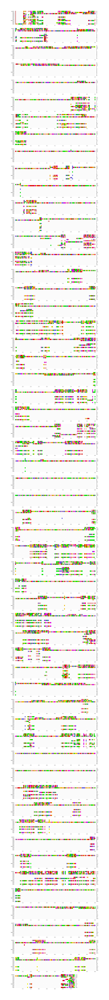

In [29]:
# Next, we load and pring the image to the screen.

# Load the image
img = mpimg.imread('BioNTech_vs_Moderna_Alignment.png')

# Display the image
fig = plt.figure(figsize=(200, 80), dpi=200)
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()

## 4) Exploring protein sequences.

In [30]:
# Now that we know that the vaccine is recognizing a gene in the third largest ORF (index = 2), 
# let's redo the alignent just for the vaccines and for that ORF.
proteinOfInterest = longestORFsequences[2]

seqFile = "sequences.fa"
alignedFile = "aligned_sequences.fa"

# Create a FASTA file with sequences
with open(seqFile, "w") as handle:
    handle.write(f">Moderna\n{ModernaAA}\n")
    handle.write(f">BNTPhi\n{BNTPhiAA}\n")
    handle.write(f">covidProtein\n{proteinOfInterest}\n") 

bashCommand = "muscle -align " + seqFile + " -output " + alignedFile
os.system(bashCommand)

# Make and save an alignment figure
mv = MsaViz(alignedFile, wrap_length=100, show_count=True)
mv.savefig("BioNTech_vs_Moderna_Alignment.png")


muscle 5.1.osx64 []  25.8Gb RAM, 8 cores
Built May 15 2023 21:29:02
(C) Copyright 2004-2021 Robert C. Edgar.
https://drive5.com

Input: 3 seqs, avg length 1276, max 1282

00:00 4.6Mb  CPU has 8 cores, running 8 threads
00:00 5.8Mb   100.0% Calc posteriors
00:01 221Mb   100.0% Consistency (1/2)
00:01 240Mb   100.0% Consistency (2/2)
00:01 253Mb   100.0% UPGMA5           
00:01 269Mb   100.0% Refining


In [31]:
# Load the image
img = mpimg.imread('BioNTech_vs_Moderna_Alignment.png')

# Display the image
fig = plt.figure(figsize=(80, 80), dpi=200)
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()

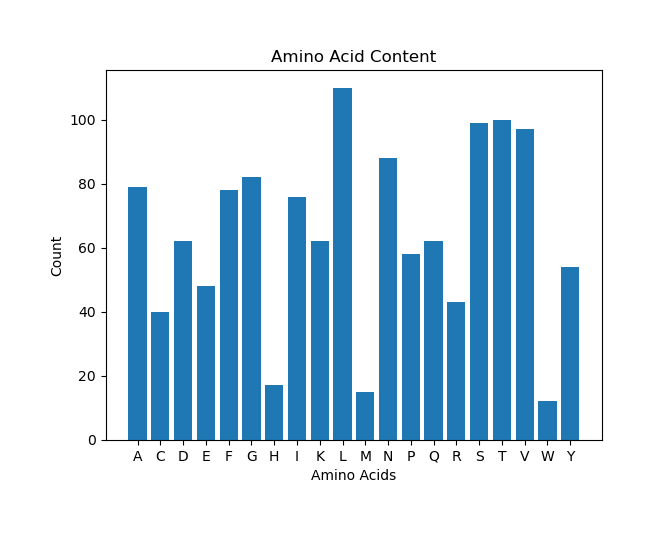

Molecular weight: 142269.17070000042


In [32]:
# Calculate amino acid count and plot as a bar chart
aa_counts = ProtParam.ProteinAnalysis(proteinOfInterest).count_amino_acids()
plt.bar(aa_counts.keys(), aa_counts.values())
plt.xlabel('Amino Acids')
plt.ylabel('Count')
plt.title('Amino Acid Content')
plt.show()

# Calculate atomic composition of the protein
atomic_composition = ProtParam.ProteinAnalysis(proteinOfInterest).get_amino_acids_percent()

# Calculate molecular weight of the protein
molecular_weight = ProtParam.ProteinAnalysis(proteinOfInterest).molecular_weight()

print("Molecular weight:", molecular_weight)

# II) BLAST Searches

## 1) Creating and running a BLAST query.

In [33]:
# The BLAST (Basic Local Alignment Search Tool) software is widely used in bioinformatics for comparing sequences, 
# and its results are fundamental to the interpretation of a wide spectrum of biological data.
# In this case, we will make a BLAST using a module of Biopython, the Bio.Blast module.

# Slice protein to only use the first 200 nucleotides
protein_sequence = proteinOfInterest[0:200]

# Set up the BLAST query for the NCBI database 
# This submits the query to the NCBI server for comparison to their database of sequences
# The 'protein-protein BLAST' (blastp) is used here
blast_result = NCBIWWW.qblast("blastp", "nr", protein_sequence)

# In Python, BLAST process is asynchronous which means the script will need to wait and 
# retrieve the result once it’s ready. 
# The handle to the results is returned from the qblast() function and can then be parsed
# The result would be in XML format which you would need to parse to get the actual BLAST_IDs 
# and associated information.

### 1.A) Downloading the BLAST results.

In [34]:
# Here, we download and save the BLAST results as an XML file.
blast_file_xml = "proteinBLASTresult.xml"
with open(blast_file_xml, "w") as out_handle:
    out_handle.write(blast_result.read())

### 1.B) Opening and exploring BLAST results

In [35]:
# In order to read the downloaded BLAST XML result file, it is useful to convert it to a FASTA file.
def convert_xml_2_fasta(blast_file_xml,blast_file_fasta):
    # Parse the BLAST XML file using NCBIXML         
    blast_records = NCBIXML.parse(open(blast_file_xml))
    with open(blast_file_fasta, "w") as handle:
        handle.write(f">Original\n{protein_sequence}\n")
        for blast_record in blast_records:
            for idx, alignment in enumerate(blast_record.alignments):
                for hsp in alignment.hsps:
                    handle.write(f">Seq{idx}\n{hsp.sbjct}\n")

blast_file_xml = "proteinBLASTresult.xml"
blast_file_fasta = "proteinBLASTresult.fa"
convert_xml_2_fasta(blast_file_xml,blast_file_fasta)                

In [36]:
# Now that we have a fasta file, we can run MUSCLE again to compute its alignment:
alignedFile = "blast_file_aligned.afa"

# Use a terminal command (bash) to run MUSCLE in to align the sequences.        
bashCommand = "muscle -align " + blast_file_fasta + " -output " + alignedFile
os.system(bashCommand)

# Make and save an alignment figure
mv = MsaViz(alignedFile, wrap_length=100, show_count=True)
mv.savefig("BLAST_Alignment.png")

# Load the image
img = mpimg.imread('BLAST_Alignment.png')

# Display the image
fig = plt.figure(figsize=(80, 80), dpi=200)
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()


muscle 5.1.osx64 []  25.8Gb RAM, 8 cores
Built May 15 2023 21:29:02
(C) Copyright 2004-2021 Robert C. Edgar.
https://drive5.com

Input: 51 seqs, avg length 192, max 200

00:00 4.6Mb  CPU has 8 cores, running 8 threads
00:01 56Mb    100.0% Calc posteriors
00:01 63Mb    100.0% Consistency (1/2)
00:01 63Mb    100.0% Consistency (2/2)
00:01 63Mb    100.0% UPGMA5           
00:01 65Mb    100.0% Refining


## 2) Running BLAST in a background thread
Often, we do not want to wait around until the blast call is complete.  For example, we may need to do this for a long list of sequences, or we might want to work on other tasks while we wait.  When this is the case, it can be helpful to run the code in the background on another thread.  As an example, the next cell shows an example where we run the BLAST on three different sequences all at the same time and in different threads.

In [37]:
''' # Function to run a BLAST query and save the result to a file
#def run_blast_query_and_save(query_sequence, result_file):
    #result_handle = NCBIWWW.qblast("blastp", "nr", query_sequence)
    #with open(result_file, "w") as out_handle:
     #   out_handle.write(result_handle.read())
    #return
  
def run_a_set_of_blast_searches(pMOD_list):
    for idx, pMOD in enumerate(pMOD_list):
        query_sequence = pMOD[:200]  # Extract the first 200 amino acids from the protein sequence
        result_file = f"blast_result_{idx + 1}.xml"  # Generate a unique result file name
        blast_thread = threading.Thread(target=run_blast_query_and_save, args=(query_sequence, result_file))
        blast_thread.start()
        print("Started BLAST Job: " + result_file)
    return
        
# Assuming pMOD_list contains multiple protein sequences
pMOD_list = [protein_sequence, ModernaAA[0:200] , BNTPhiAA[0:200] ]  # Replace with your protein sequences

# Call function to run BLAST queries for each protein sequence in a separate thread
run_a_set_of_blast_searches(pMOD_list)'''

Started BLAST Job: blast_result_1.xml
Started BLAST Job: blast_result_2.xml
Started BLAST Job: blast_result_3.xml


## 3) Exploring Evolutionary History of Multiple Sequences
To understand the evolutionary history of sequences, we can make phylogenetic trees. Let's try that with our BLAST results.

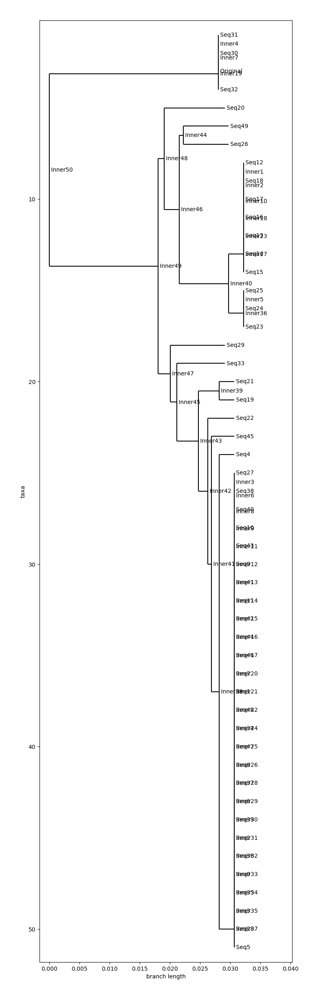

                                                         , Seq31
                                                         |
                                                         | Seq30
                                                         |
  _______________________________________________________| Original
 |                                                       |
 |                                                       | Seq32
 |
 |                                      ___________________ Seq20
 |                                     |
 |                                     |      ______________ Seq49
 |                                     |    ,|
 |                                     |    ||______________ Seq26
 |                                    _|    |
_|                                   | |    |                     , Seq12
 |                                   | |    |                     |
 |                                   | |    |                     | Seq18
 |     

In [38]:
def makeTree(alignedFile):
    # read our alignment file.
    align = AlignIO.read(alignedFile, 'fasta')

    # define sequence distance metric
    calculator = DistanceCalculator('identity')
    dm  = calculator.get_distance(align)

    # construct tree
    constructor = DistanceTreeConstructor()
    return constructor.upgma(dm), dm

tree, dm = makeTree(alignedFile)

# plot tree
fig, ax = plt.subplots(figsize=(8, 30))  # Adjust size as needed
Phylo.draw(tree,axes=ax)
Phylo.draw_ascii(tree)

In [39]:
# The numerical distances can be found in the distance matrix "dm"
print(dm)

print(f'The phylogenetic distance between {dm.names[0]} and {dm.names[4]} is {dm[0,4]}')
print(f'The phylogenetic distance between {dm.names[1]} and {dm.names[4]} is {dm[1,4]}')

Seq5    0.000000
Seq28   0.000000    0.000000
Seq23   0.015000    0.015000    0.000000
Seq15   0.010000    0.010000    0.005000    0.000000
Seq24   0.015000    0.015000    0.000000    0.005000    0.000000
Seq3    0.000000    0.000000    0.015000    0.010000    0.015000    0.000000
Seq35   0.000000    0.000000    0.015000    0.010000    0.015000    0.000000    0.000000
Seq0    0.000000    0.000000    0.015000    0.010000    0.015000    0.000000    0.000000    0.000000
Seq19   0.005000    0.005000    0.020000    0.015000    0.020000    0.005000    0.005000    0.005000    0.000000
Seq36   0.000000    0.000000    0.015000    0.010000    0.015000    0.000000    0.000000    0.000000    0.005000    0.000000
Seq32   0.045000    0.045000    0.060000    0.055000    0.060000    0.045000    0.045000    0.045000    0.050000    0.045000    0.000000
Seq2    0.000000    0.000000    0.015000    0.010000    0.015000    0.000000    0.000000    0.000000    0.005000    0.000000    0.045000    0.000000
Seq3

### 3.A) Explore different Covid variants.

In [40]:
variants = [["wuhan","MN908947"],
    ["delta","OK091006"],
    ["beta","MZ433432"],
    ["alpha","MZ773928"],
    ["omicron","PP028445"],
    ["OP208953","OP208953"],
    ["MT628218","MT628218"]]

sequenceEntry = []
for i in range(len(variants)):
    print(i,variants[i][1])
    sequenceEntry.append(get_genbank(variants[i][1]))

0 MN908947
1 OK091006
2 MZ433432
3 MZ773928
4 PP028445
5 OP208953
6 MT628218


In [41]:
variant_file_fasta = "covid_variants.fa"
with open(variant_file_fasta, "w") as handle:
    for idx in range(len(variants)):
        # Find and record the third largest ORF for each sequence
        orf_positions = find_all_orfs(sequenceEntry[idx].seq)
        longestORFbounds = pickNLargestORF(orf_positions,5)
        proteinOfInterest = sequenceEntry[idx].seq[longestORFbounds[2][0]:].translate(to_stop=True)

        startMod, stopMod = pickLargestORF(Moderna_orf_positions)
        handle.write(f">{variants[idx][0]}\n{proteinOfInterest}\n")

In [42]:
# Now that we have a fasta file, we can run MUSCLE again to 
# compute and plot its alignment:
alignedFile = "covid_variants_aligned.afa"

# Use a terminal command (bash) to run MUSCLE in to align the sequences.        
bashCommand = "muscle -align " + variant_file_fasta + " -output " + alignedFile
os.system(bashCommand)

# Make and save an alignment figure
mv = MsaViz(alignedFile, wrap_length=150, show_count=True)
mv.savefig("Variant_Alignment.png")

# Load the image
img = mpimg.imread('Variant_Alignment.png')

# Display the image
fig = plt.figure(figsize=(80, 80), dpi=200)
plt.imshow(img)
plt.axis('off')  # Hide axis
plt.show()


muscle 5.1.osx64 []  25.8Gb RAM, 8 cores
Built May 15 2023 21:29:02
(C) Copyright 2004-2021 Robert C. Edgar.
https://drive5.com

Input: 7 seqs, avg length 1279, max 1282

00:00 4.5Mb  CPU has 8 cores, running 8 threads
00:00 740Mb   100.0% Calc posteriors
00:00 643Mb   100.0% Consistency (1/2)
00:00 656Mb   100.0% Consistency (2/2)
00:00 656Mb   100.0% UPGMA5           
00:01 659Mb   100.0% Refining


In [43]:
# Compute the phylogenetic tree using our previous function:
tree = makeTree(alignedFile)

# plot tree
Phylo.draw_ascii(tree)

AttributeError: 'tuple' object has no attribute 'get_terminals'

In [ ]:
# The numerical distances can be found in the distance matrix "dm"
print(dm)

print(f'The phylogenetic distance between {dm.names[0]} and {dm.names[4]} is {dm[0,4]}')
print(f'The phylogenetic distance between {dm.names[1]} and {dm.names[4]} is {dm[1,4]}')

alpha   0.000000
omicron 0.046022    0.000000
OP208953    0.028081    0.024961    0.000000
beta    0.014041    0.049142    0.030421    0.000000
wuhan   0.008580    0.046802    0.027301    0.008580    0.000000
delta   0.014821    0.046022    0.028081    0.015601    0.008580    0.000000
MT628218    0.007800    0.046022    0.026521    0.007800    0.000780    0.007800    0.000000
    alpha   omicron OP208953    beta    wuhan   delta   MT628218
The phylogenetic distance between alpha and wuhan is 0.00858034321372858
The phylogenetic distance between omicron and wuhan is 0.046801872074882955


Want to add some more variants to the plot.  See here for a much larger tree:
https://www.bv-brc.org/view/VariantLineage/#view_tab=phlyogeny